# Section 1: Project Overview

#### Provide an overview of your project including the research questions. You may start with the text from your proposal but it must be edited for clarity and any updates to your thinking.

##### Overview and Research Questions:
As we all know, with such an increase in crime rate, it is the need of the hour to analyze the available data and try to come up with some necessary and efficient solutions to tackle this grim situation. This can help us to predict and analyze the nature of the criminal activities. The technique of data analysis and predictions is widely used in nearly all sectors such as business, healthcare and so on, but in the field of crime, we believe that it has still not been used to its fullest or in the way it should have been. Since, it is vital to understand these patterns of criminal activities to counter them effectively, we are going to perform data analysis on the crime data.

We are going to analyze the data of Baltimore city, scraped from a publicly available website of the Baltimore Police Department. The overall crime rate in Baltimore is 153% higher than the national average. For every 100,000 people, there are 19.06 daily crimes that occur in Baltimore. Baltimore has been in the list of the top dangerous cities of the United States. So, we are planning to come up with some efficient results or predictions using which the police can change or update their ways of operation depending on the location, time and many other factors. This will help the police to tackle various situations in a more efficient way. 

##### Updates:
Earlier, we decided to analyze crime data for the city of Boston but later changed our focus from Boston Police Department to Baltimore Police Department. Also, we thought that as we live near Baltimore, it would be better to analyze the data of our surroundings and get more insight into the criminal activities around us and hopefully be able to come up with some useful results.

The dataset provides the details about the date of crime, the time when the incident occurred, place where it occurred, whether it was inside or outside, whether any weapons were used, and some description, etc. We will be analyzing criminal activities based on various fields like location, time, date, age, sex, race, description and predicting criminal behavior. We are planning to perform data visualization with the help of different statistical models, and also are planning to plot maps. These maps will help us to locate, sort and analyze the different areas and compare them based on the factors mentioned in the analysis part.

# Section 2: Milestones and Progress

#### In bullet points or a table, list the project milestones from your proposal for dates up to November 4th. Have you met these milestones? If not, explain what you will do to catch up. 

##### Data Collection:
1. Searched online for different kinds of data available
2. This is when we came across the data for Baltimore and decided to change it to Baltimore

##### Data Scraping and Pre-processing: 
1. Fetched data from the Baltimore Police Website available for public

##### Data Cleaning and Data Exploration:
1. Indexed the data
2. Renamed the columns
3. Dropped the unnecessary columns and rearranged the columns
4. Changed data types
5. Handled the NaN and Null Values
6. Added dummy variables for the types of crimes
7. Found the total number of crimes according to their types
8. Data renaming 

# Section 3: Data Acquisition and Cleaning Code

#### Please provide code that demonstrates that you have made progress with data acquisition and cleaning. In a markdown cell at the top of the section, summarize what you have accomplished thus far.

In [1]:
#importing data set
import pandas as pd
pd.set_option('display.max_columns', None)
df=pd.read_csv('BPD_Arrest_Based_Crime_Data.csv')
df.head()

,Arrest_ID,CrimeDate,CrimeTime,CrimeCode,Location,Description,Inside/Outside,Weapon,Post,District,Neighborhood,Longitude,Latitude,Location 1,Premise,vri_name1,Total Incidents,Age,Sex,Race
0,19029683.0,10/26/2019,07:30:00,4C,1800 EAGLE ST,AGG. ASSAULT,Outside,OTHER,934.0,SOUTHERN,CARROLLTON RIDGE,-76.644860,39.281137,NaN,STREET,NaN,1,29.0,M,B
1,19094289.0,10/26/2019,01:30:00,4E,1400 PORTER ST,COMMON ASSAULT,Outside,NaN,943.0,SOUTHERN,NaN,-76.597654,39.270330,NaN,STREET,NaN,1,36.0,M,B
2,19093811.0,10/26/2019,21:45:00,6C,1000 GREENMOUNT AVE,LARCENY,NaN,NaN,313.0,EASTERN,JOHNSTON SQUARE,-76.607242,39.301386,NaN,NaN,NaN,1,45.0,F,B
3,19028506.0,10/26/2019,18:00:00,4C,1800 N COLLINGTON AVE,AGG. ASSAULT,NaN,OTHER,331.0,EASTERN,BROADWAY EAST,-76.587482,39.311019,NaN,NaN,NaN,1,39.0,M,B
4,19027327.0,10/26/2019,02:10:00,4E,1400 ORLEANS ST,COMMON ASSAULT,Outside,NaN,321.0,EASTERN,DUNBAR,-76.598613,39.295176,NaN,STREET,NaN,1,45.0,M,B


In [2]:
#Renaming columns
df.rename(columns={'CrimeDate':'Date', 'CrimeTime':'Time', 'CrimeCode':'Code', 'vri_name1':'VRI', 'Inside/Outside':'Inside_Outside', 'Age':'Offender_Age', 'Sex':'Offender_Sex','Race':'Offender_Race'}, inplace=True)

#Dropping columns
df=df.drop(columns=['Location 1','Total Incidents'])

#Rearranging columns
df=df[['Arrest_ID', 'Date', 'Time', 'Code', 'Description', 'Offender_Age', 'Offender_Sex', 'Offender_Race', 'Weapon', 'Location', 'Post', 'District', 'Neighborhood', 'Inside_Outside', 'Premise', 'Latitude', 'Longitude', 'VRI']]

#Madifying data types
df['Date']=pd.to_datetime(df['Date'])
df['Time']=pd.to_datetime(df['Time'])
df['Time']=pd.to_timedelta(df['Time'].dt.strftime('%H:%M:%S'))
df[['Latitude', 'Longitude', 'Offender_Age']]=df[['Latitude', 'Longitude', 'Offender_Age']].apply(pd.to_numeric)
df[['Arrest_ID']]=df[df['Arrest_ID'].isnull()==False]['Arrest_ID'].astype(int).astype(str)
df[['Post']]=df[['Post']].astype('object')

In [3]:
df.dtypes

Arrest_ID                  object
Date               datetime64[ns]
Time              timedelta64[ns]
Code                       object
Description                object
Offender_Age              float64
Offender_Sex               object
Offender_Race              object
Weapon                     object
Location                   object
Post                       object
District                   object
Neighborhood               object
Inside_Outside             object
Premise                    object
Latitude                  float64
Longitude                 float64
VRI                        object
dtype: object

In [4]:
#Handling null values
df.Arrest_ID.fillna('NA', inplace=True)
df.Time.fillna(0, inplace=True)
df.Offender_Age.fillna('NA', inplace=True)
df.Weapon.fillna('NA', inplace=True)
df.Location.fillna('NA', inplace=True)
df.Post.fillna('NA', inplace=True)
df.Neighborhood.fillna('NA', inplace=True)
df.Inside_Outside.fillna('NA', inplace=True)
df.Premise.fillna('NA', inplace=True)
df.Latitude.fillna('NA', inplace=True)
df.Longitude.fillna('NA', inplace=True)
import numpy as np
df.Latitude = np.where(df.Longitude.eq('NA'), 'NA', df.Latitude)
df.Longitude = np.where(df.Latitude.eq('NA'), 'NA', df.Longitude)
df.VRI.fillna('NA', inplace=True)

C:\Users\manas\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Passing integers to fillna is deprecated, will raise a TypeError in a future version.  To retain the old behavior, pass pd.Timedelta(seconds=n) instead.
  This is separate from the ipykernel package so we can avoid doing imports until


In [5]:
#Renaming values of 'Description' column
df['Description'].replace(['AGG. ASSAULT', 'COMMON ASSAULT'],['ASSAULT - AGGRAVATED', 'ASSAULT - COMMON'], inplace=True)
df['Description'].unique()

array(['ASSAULT - AGGRAVATED', 'ASSAULT - COMMON', 'LARCENY',
       'ROBBERY - RESIDENCE', 'LARCENY FROM AUTO', 'ROBBERY - STREET',
       'BURGLARY', 'AUTO THEFT', 'ROBBERY - CARJACKING',
       'ROBBERY - COMMERCIAL', 'SHOOTING', 'HOMICIDE', 'ARSON', 'RAPE'],
      dtype=object)

In [6]:
#Creating dummies for each type of criminal activity
crimeDesc=list(df['Description'].unique())
crimeDesc=[d.split(' ', 1)[0] if d!='AUTO THEFT' else d for d in crimeDesc]
crimeDesc=list(dict.fromkeys(crimeDesc))
df=pd.concat([df, df.Description.str.findall('|'.join(crimeDesc)).str[0].str.get_dummies()], axis=1)

In [7]:
df.head()

,Arrest_ID,Date,Time,Code,Description,Offender_Age,Offender_Sex,Offender_Race,Weapon,Location,Post,District,Neighborhood,Inside_Outside,Premise,Latitude,Longitude,VRI,ARSON,ASSAULT,AUTO THEFT,BURGLARY,HOMICIDE,LARCENY,RAPE,ROBBERY,SHOOTING
0,19029683,2019-10-26,07:30:00,4C,ASSAULT - AGGRAVATED,29,M,B,OTHER,1800 EAGLE ST,934,SOUTHERN,CARROLLTON RIDGE,Outside,STREET,39.2811,-76.6449,NA,0,1,0,0,0,0,0,0,0
1,19094289,2019-10-26,01:30:00,4E,ASSAULT - COMMON,36,M,B,NA,1400 PORTER ST,943,SOUTHERN,NA,Outside,STREET,39.2703,-76.5977,NA,0,1,0,0,0,0,0,0,0
2,19093811,2019-10-26,21:45:00,6C,LARCENY,45,F,B,NA,1000 GREENMOUNT AVE,313,EASTERN,JOHNSTON SQUARE,NA,NA,39.3014,-76.6072,NA,0,0,0,0,0,1,0,0,0
3,19028506,2019-10-26,18:00:00,4C,ASSAULT - AGGRAVATED,39,M,B,OTHER,1800 N COLLINGTON AVE,331,EASTERN,BROADWAY EAST,NA,NA,39.311,-76.5875,NA,0,1,0,0,0,0,0,0,0
4,19027327,2019-10-26,02:10:00,4E,ASSAULT - COMMON,45,M,B,NA,1400 ORLEANS ST,321,EASTERN,DUNBAR,Outside,STREET,39.2952,-76.5986,NA,0,1,0,0,0,0,0,0,0


## Data Visualization and Analysis

In [8]:
#importing pyplot
import matplotlib.pyplot as plt
%matplotlib inline
import calendar

### Analysis 1: The distribution of arrests across every month of the year from 2016 to 2019 in Baltimore City

Text(0.5, 1.0, 'Arrests across Months')

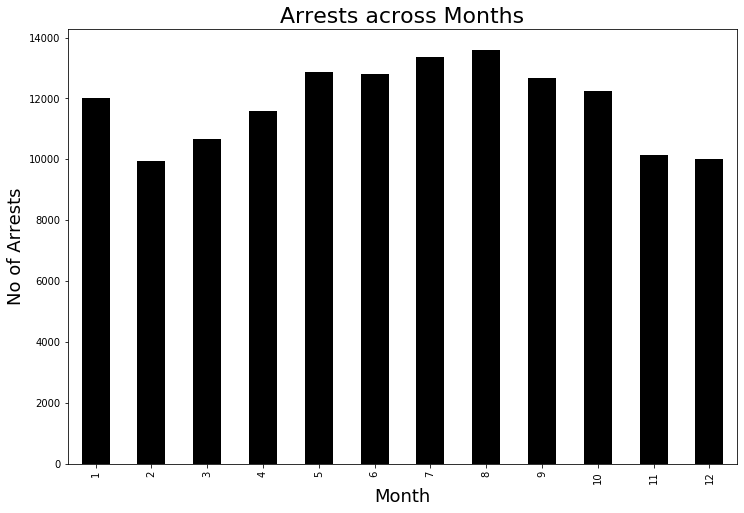

In [9]:
plt.figure(figsize = (12,8))
(df['Date']
.groupby(df.Date.dt.month)
.agg('count')
.plot.bar(color='black')
)
plt.xlabel('Month', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)
plt.title('Arrests across Months', fontsize = 22)

- This bar graph gives the number of arrests per month from 2016-2019. 
- The month of August has the highest number of criminal activities as the number of arrests indicate, closely followed by the month of July.
- The month of February has the lowest number of arrests, followed by December and November, indicating lesser criminal - activities in these months of the year.
- From this bar graph we can analyze that the number of criminal activities is higher in summer season and gradually decreases after summer season but gets pretty high in the month of January. 

### Analysis 2: The distribution of arrests accross different districts compared to different ages made by Baltimore Police Department

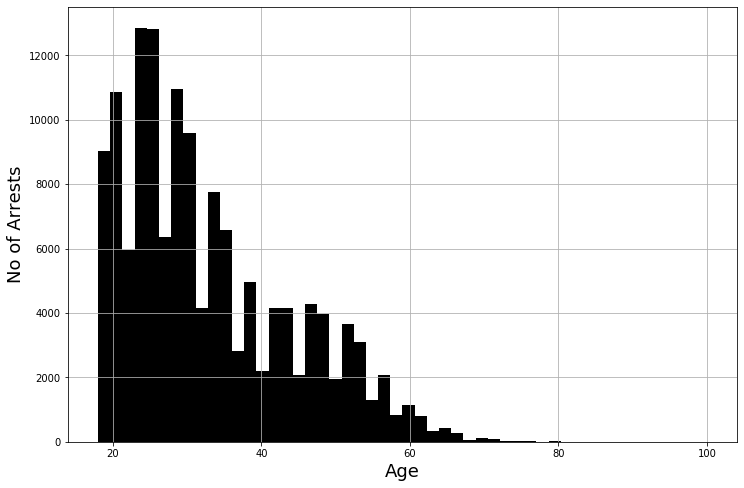

In [10]:
plt.figure(figsize=(12,8))
plt.xlabel('Age', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)
df[df['Offender_Age']!='NA'].Offender_Age.hist(bins=50, color= 'black')

- This graph shows the distribution of number of arrests accross differnt age groups. 

Text(0.5, 1.0, 'Distribution of Arrests across various Districts')

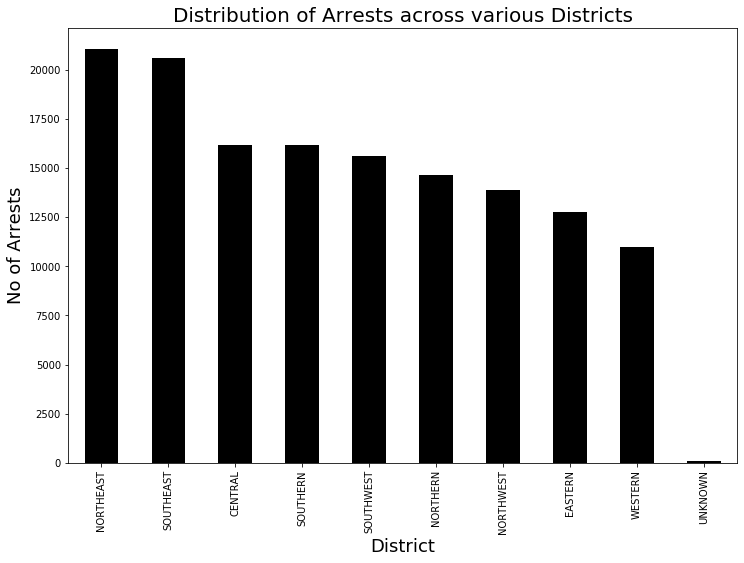

In [11]:
plt.figure(figsize = (12,8))
df['District'].value_counts().plot.bar(stacked=True, color='black')
plt.xlabel('District', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)
plt.title('Distribution of Arrests across various Districts', fontsize=20)

- The graph above represents arrest data across various districts in Baltimore.

Text(0.5, 1.0, 'Arrests across District and Age')

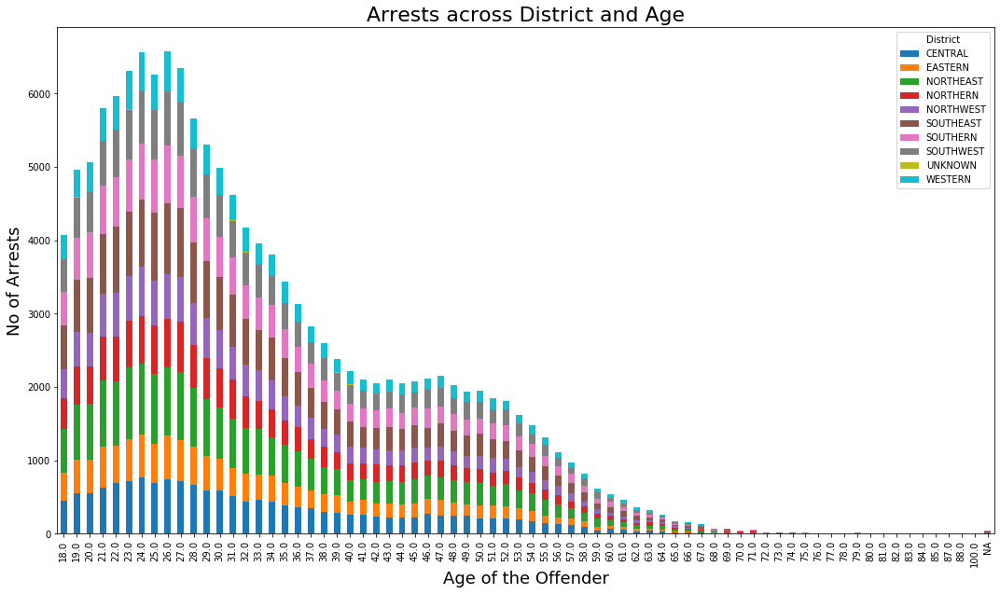

In [12]:
(df.pivot_table('Arrest_ID', index='Offender_Age', columns='District', aggfunc = 'count', fill_value=0)
.plot(kind='bar', stacked = True, figsize=(18,10)))

plt.xlabel('Age of the Offender', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)
plt.title('Arrests across District and Age', fontsize = 22)

- From this stack bar graph it can be analyzed that, 19-31 age group has the most number of people involved in criminal activities. 
- After analyzimg the graph we can conclude that, the people are more like to get involved in criminal activities from the age of 19. 
- Amomg all the arrested people, a person with an age of 26 is arrested more often. Thus, a person with a age of 26 is most likely to get involved in a criminal activities.
- We can observe from the graph, the count decreases gradually from age 27 to 42.
- After that, there is slight increase in the count of arrests between age group 43-51 and gradually decreses after that period.
- We can also analyze that people from the Northeast district are more likely to get involved in criminal activities. Therefore, crime rate in Northeast district is highest.



### Analysis 3: The distribution of number of arrests across Different races compared with different ages

Text(0.5, 1.0, 'Distribution of Arrests across Race and Age')

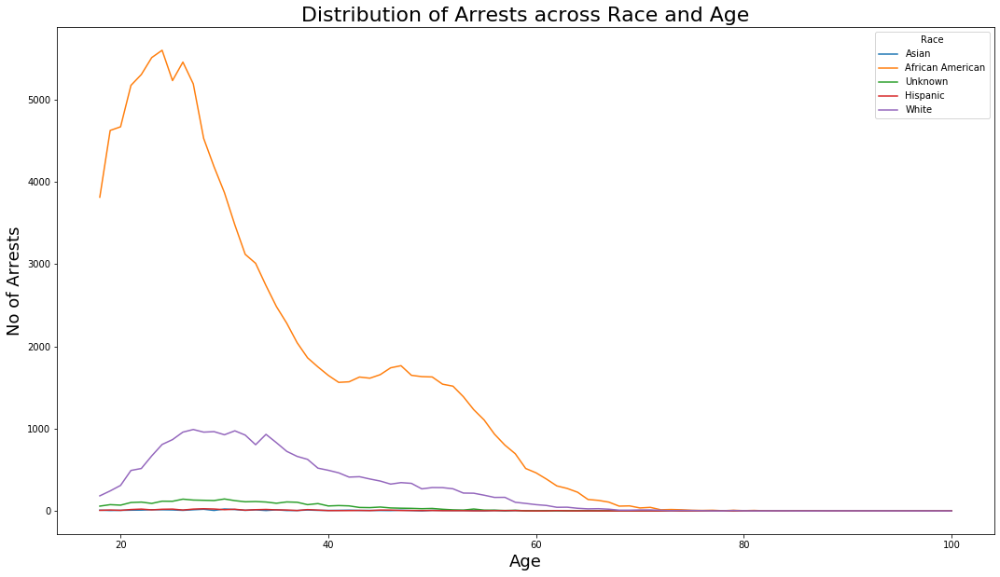

In [13]:
#Pivoting the table
df_new = df[df.Offender_Age!='NA'].pivot_table('Arrest_ID', index='Offender_Age', columns='Offender_Race', aggfunc = 'count', fill_value=0)
plt.figure(figsize=(18,10))
plt.plot(df_new['A'], label='Asian')
plt.plot(df_new['B'], label='African American')
plt.plot(df_new['U'], label='Unknown')
plt.plot(df_new['H'], label='Hispanic')
plt.plot(df_new['W'], label='White')

plt.legend(loc="upper right", title='Race')
plt.xlabel('Age', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)
plt.title('Distribution of Arrests across Race and Age', fontsize = 22)

- The above line graph can be used to analyze the number of arrests with different age groups and race.
- From the graph we can analyze that, the people belonging to african american(black) population are more likely to get involved in criminal activities, as the arrest count of black population is higher than compared to population belonging to other race group.
- This above statement can be backed up by the fact, that baltimore has higher number of african american(black) population compared to other races, so the number of arrests for black population is higher.
- The age group of 23-28 has the highest number of arrests, and we can see same trend in every other races. 

### Analysis 4: The distribution of number of arrests accross the year of 2016 to 2019 considering the gender of the criminal

Text(0, 0.5, 'No of Arrests')

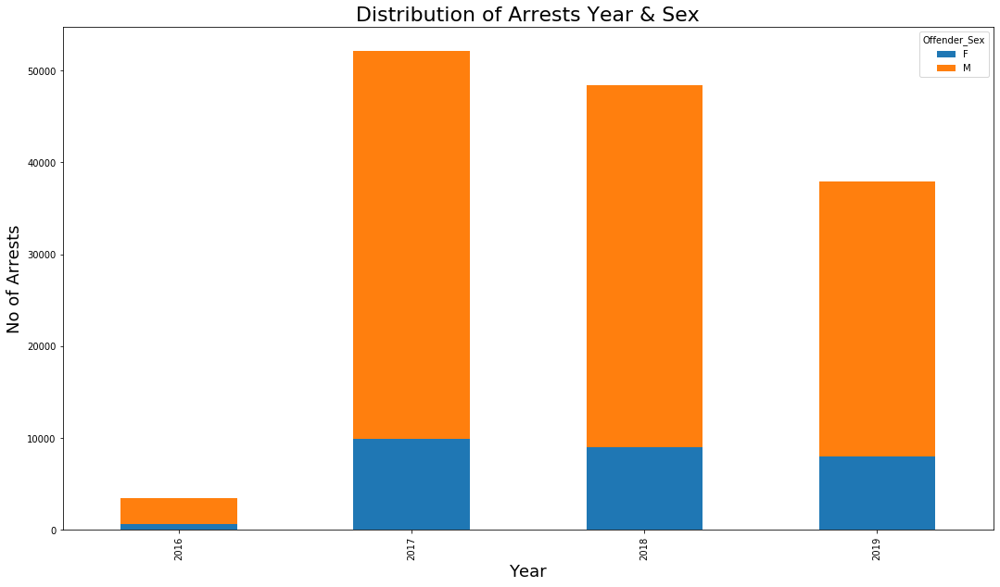

In [14]:
(df.pivot_table('Arrest_ID', index=df.Date.dt.year, columns='Offender_Sex', aggfunc = 'count', fill_value=0)
.plot(kind='bar',stacked=True, figsize=(18,10)))

plt.title('Distribution of Arrests Year & Sex', fontsize = 22)
plt.xlabel('Year', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)

- This graph shows the distribution of arrests per year and accross male and female.
- We can conclude that Men are more involved in criminal activities compared to Women in Baltimore. Therefore, Men are more likely to get arrested than Women. 
- As, the data for the year 2016 is not adequate, that shows less number of arrests.
- From 2017, we can see that, the number of arrests are decresing every year, from which we can conclude that there is a decrease in crime rate from the year of 2017 to 2019.

### Analysis 5: The distribution of number of arrests by time on a particular day over the years

C:\Users\manas\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3325: FutureWarning: Passing timedelta64-dtype data is deprecated, will raise a TypeError in a future version
  exec(code_obj, self.user_global_ns, self.user_ns)


Text(0, 0.5, 'No of Arrests')

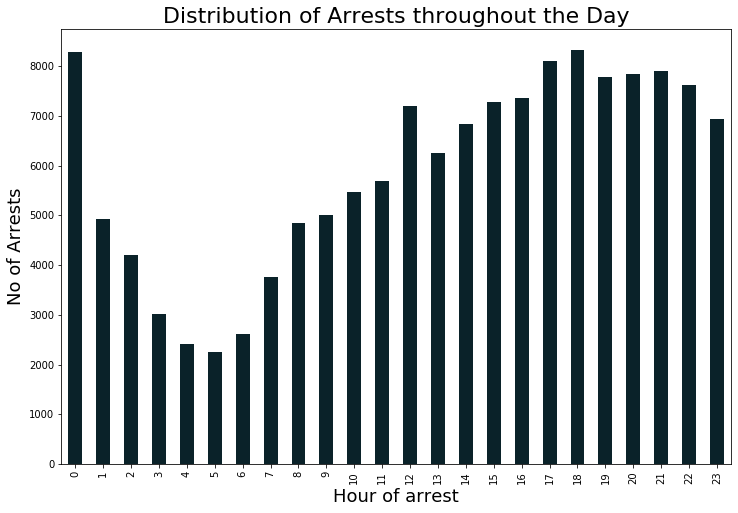

In [15]:
plt.figure(figsize = (12,8))
(df['Date']
.groupby(pd.to_datetime(df.Time).dt.hour)
.agg('count')
.plot.bar(stacked=True, color='#0A2229')
)
plt.title('Distribution of Arrests throughout the Day', fontsize = 22)
plt.xlabel('Hour of arrest', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)

- From observing above graph we can infer that highest number of crime takes place from 3 p.m to 12 a.m. Therefore, we can also conclude that during these hours the frequency of criminal activity is higher.
- The arrest rate falls after 1 a.m. and is very low till 9 in the morning.

C:\Users\manas\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3325: FutureWarning: Passing timedelta64-dtype data is deprecated, will raise a TypeError in a future version
  exec(code_obj, self.user_global_ns, self.user_ns)


Text(0.5, 1.0, 'Distribution of arrests on a particular day in Weekday and Time')

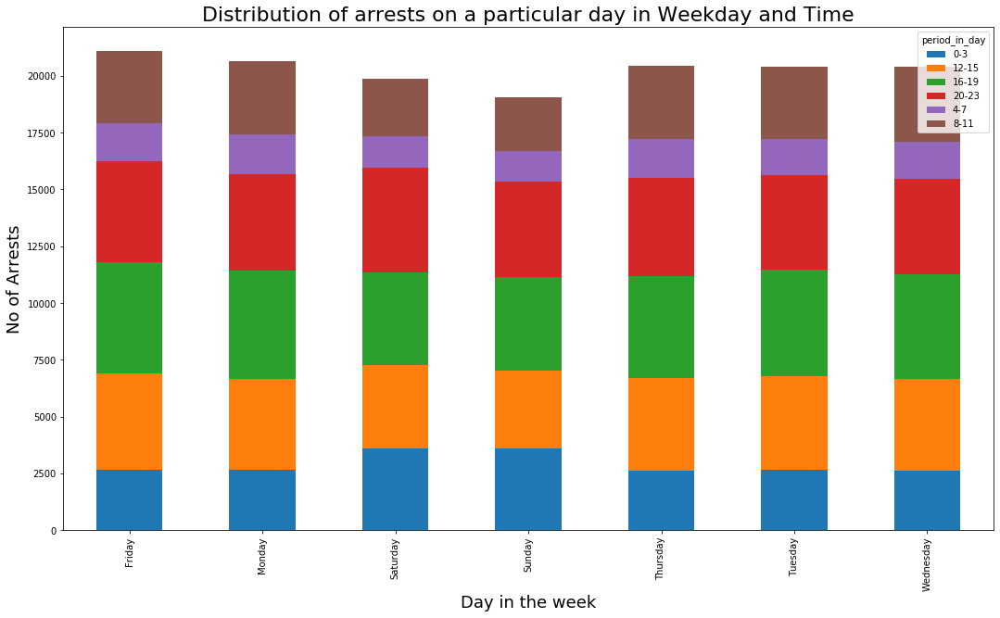

In [16]:
hour_period_map = {
0 : '0-3',
1 : '0-3',
2 : '0-3',
3 : '0-3',
4 : '4-7',
5 : '4-7',
6 : '4-7',
7 : '4-7',
8 : '8-11',
9 : '8-11',
10 : '8-11',
11 : '8-11',
12 : '12-15',
13 : '12-15',
14 : '12-15',
15 : '12-15',
16 : '16-19',
17 : '16-19',
18 : '16-19',
19 : '16-19',
20 : '20-23',
21 : '20-23',
22 : '20-23',
23 : '20-23',
}
df['period_in_day'] = pd.to_datetime(df.Time).dt.hour.map(lambda time : hour_period_map[time])
df['weekday'] = df['Date'].dt.weekday_name
(df.pivot_table('Arrest_ID', index='weekday', columns='period_in_day', aggfunc = 'count', fill_value=0)
.plot(kind='bar',stacked=True, figsize=(18,10)))

plt.xlabel('Day in the week', fontsize=18)
plt.ylabel('No of Arrests', fontsize=18)
plt.title('Distribution of arrests on a particular day in Weekday and Time', fontsize = 22)

- This stack bar graph depicts the distribution of arrests accross the days of the week and also accross the time on that day. 
- We can observe that Sunday and Saturday has the least number of arrests. Thus, we can infer that, there are fewer number of criminal activities on weekends compared to weekdays.
- We can also observe that more number of arrests takes place between the time of 4 p.m. to 11 p.m. Therefore, it is possible that most criminal activities take place between this time.
- We can also observe that there are fewer numbe rof arrests between the time of 8 a.m. to 11 a.m. Thus, it is possible that between these hours fewer criminal activites take place in Baltimore.

### Analysis 6: Map consisting of different locations of crime that took place in Baltimore from the year 2016 - 2019

In [17]:
#Importing graph objects for plotting maps
import plotly.graph_objects as go
import plotly as py
import datetime
py.offline.init_notebook_mode(connected = True)

#setting access token
mapbox_access_token = 'pk.eyJ1IjoibWFuYXNtaXNocmEwNyIsImEiOiJjazNzcHR0bHAwNTRhM2RteWQ2b2F4ZDBiIn0.xYDD-sP_bsZJB0LXEWcOiA'

#fetching date as string in a specific format
df['Date_Str']=df['Date'].apply(lambda x: datetime.datetime.strftime(x, '%m-%d-%Y'))

#creating dataframes for different types of criminal activities
df_ASSAULT=df[df['ASSAULT']==1]
df_LARCENY=df[df['LARCENY']==1]
df_ROBBERY=df[df['ROBBERY']==1]
df_BURGLARY=df[df['BURGLARY']==1]
df_AUTO_THEFT=df[df['AUTO THEFT']==1]
df_SHOOTING=df[df['SHOOTING']==1]
df_HOMICIDE=df[df['HOMICIDE']==1]
df_ARSON=df[df['ARSON']==1]
df_RAPE=df[df['RAPE']==1]

#creating markers using scattermapbox for different criminal activities
data_ASSAULT=go.Scattermapbox(lon = df_ASSAULT['Longitude'], 
                         lat = df_ASSAULT['Latitude'],
                         mode='markers', 
                         name='ASSAULT',
                         marker = dict(color='red', symbol= 'circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_ASSAULT[['Date_Str', 'Location']])
data_LARCENY=go.Scattermapbox(
                         lon = df_LARCENY['Longitude'], 
                         lat = df_LARCENY['Latitude'],
                         mode = 'markers', 
                         name = 'LARCENY',
                         marker = dict(color='orange', 
                                       symbol='circle', 
                                       opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_LARCENY[['Date_Str', 'Location']])
data_ROBBERY=go.Scattermapbox(lon = df_ROBBERY['Longitude'], 
                         lat = df_ROBBERY['Latitude'],
                         mode='markers', 
                         name='ROBBERY',
                         marker = dict(color='yellow', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_ROBBERY[['Date_Str', 'Location']])
data_BURGLARY=go.Scattermapbox(lon = df_BURGLARY['Longitude'], 
                         lat = df_BURGLARY['Latitude'],
                         mode='markers', 
                         name='BURGLARY',
                         marker = dict(color='green', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_BURGLARY[['Date_Str', 'Location']])
data_AUTO_THEFT=go.Scattermapbox(lon = df_AUTO_THEFT['Longitude'], 
                         lat = df_AUTO_THEFT['Latitude'],
                         mode='markers', 
                         name='AUTO THEFT',
                         marker = dict(color='blue', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_AUTO_THEFT[['Date_Str', 'Location']])
data_HOMICIDE=go.Scattermapbox(lon = df_HOMICIDE['Longitude'], 
                         lat = df_HOMICIDE['Latitude'],
                         mode='markers', 
                         name='SHOOTING',
                         marker = dict(color='brown', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_HOMICIDE[['Date_Str', 'Location']])
data_SHOOTING=go.Scattermapbox(lon = df_SHOOTING['Longitude'], 
                         lat = df_SHOOTING['Latitude'],
                         mode='markers', 
                         name='HOMICIDE',
                         marker = dict(color='purple', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_SHOOTING[['Date_Str', 'Location']])
data_ARSON=go.Scattermapbox(lon = df_ARSON['Longitude'], 
                         lat = df_ARSON['Latitude'],
                         mode='markers', 
                         name='ARSON',
                         marker = dict(color='pink', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_ARSON[['Date_Str', 'Location']])
data_RAPE=go.Scattermapbox(lon = df_RAPE['Longitude'], 
                         lat = df_RAPE['Latitude'],
                         mode='markers', 
                         name='RAPE',
                         marker = dict(color='black', symbol='circle', opacity=0.75),
                         line=dict(color='rgb(200,200,200)'),
                         text = df_RAPE[['Date_Str', 'Location']])

#creating list of dataframes
data=[data_ASSAULT, data_LARCENY, data_ROBBERY, data_BURGLARY, data_AUTO_THEFT, data_SHOOTING, data_HOMICIDE, data_ARSON, data_RAPE]

#setting the layout of the map
layout = go.Layout(title = 'Crimes in Baltimore city',
                   autosize = True,
                   hovermode = 'closest',
                   showlegend = True,
                   mapbox = dict(accesstoken = mapbox_access_token,
                                 bearing = 0,
                                 center = dict(lat = 39.2904, lon = -76.6122),
                                 pitch = 0,
                                 zoom = 9.5,
                                 style = 'light'))
fig = dict(data = data, layout = layout)

#plotting map
py.offline.iplot(fig)

In [18]:
#calculating the arrest counts for each crime
count_df=pd.DataFrame([(column, df[column].sum()) for column in crimeDesc], columns=['Crime', 'Count']).sort_values(by='Count', ascending=False)
count_df=count_df.set_index('Crime')
count_df

,Count
Crime,
LARCENY,48587
ASSAULT,40963
BURGLARY,19286
ROBBERY,16363
AUTO THEFT,12268
SHOOTING,2075
RAPE,949
HOMICIDE,948
ARSON,481


- The above map shows the location where a particular crime took place and each color shows the type of crime that took place at that particular location. Each location also shows the type of the crime that took place at that location. It is also possible to get the latitude and longitude of the location in Baltimore. 
- We can analyze that most common activity was Larceny followed by assault and burglary.
- The least common crime was Arson.
- Firearm was used in total number of 2075 criminal activities

In [19]:
#visualising shooting crime data in Baltimore
#importing folium to plot map
from folium.plugins import MarkerCluster
import folium

df_n=df[df['Latitude']!='NA']
df_n=df_n[df_n['Latitude']!='NA']
df_n=df_n[df_n['SHOOTING']==1]

def getIO(loc):
    if loc=='Inside':
        return 'Indoor Shooting'
    elif loc=='Outside':
        return 'Public Shooting'
    else:
        return 'Not Available'

#setting up map
b_map=folium.Map(location=[39.2904, -76.6122], zoom_start=13)
mc = MarkerCluster()

#setting up markers
for row in df_n.iterrows():
    mc.add_child(folium.Marker(location = [row[1]['Latitude'],row[1]['Longitude']], popup=getIO(row[1]['Inside_Outside'])))

b_map.add_child(mc)
#plotting map
b_map

- The above map shows the location where shooting took place in Baltimore.
- The shooting sites are clustered together for a small area and represented by the number of shooting incidents that took place in that area
- It also tells us whether shooting took place indoors or in a public place
- A total of 2075 shooting incidents we reported in Baltimore between 2016 and 2019

## Conclusion

In this project, we explored various crimes that took place in Baltimore city, Maryland between end of 2016 to mid 2019. We used different types of visualizations like hisotgram, staked bar plot, line graphs and maps to answer questions like:
- which area is prone to crimes?
- which age group is more involved in criminal activities?
- what time of the day is unsafe?
- how does various factors like race, gender related to crimes? and so on

We found that the most common type of crime reported was Larceny. Males were more involved in a crime when compared to females. The majority of criminals belonged to the age group of 18 to 35 and with increase in age, the number of offenders decrease.

We were successful to in mapping all the aspects of the criminal activities that took place in Baltimore. We were to able to analyze the overall nature of the criminal behavior in Baltimore. This analysis can be used by BPD and general public to avoid any criminal encounters, and decrease the overall crime rate in Baltimore. Finally, with the help of our analysis, BPD can improve their operations in order to tackle various criminal and illegal activities.